<H1>Import modules</H1>

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing
import re #pattern searching in a string
import plotly.express as px
import plotly as py
import matplotlib.pyplot as plt 
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style='darkgrid')
import warnings
warnings.filterwarnings("ignore")

<H2>Read data files 2020, 2021 and 2022 and display shape</H2>


In [2]:
# df18 = pd.read_csv("../DataSet/transactions/data_2018.csv", parse_dates=['transaction_date'])
# df19 = pd.read_csv("../DataSet/transactions/data_2019.csv", parse_dates=['transaction_date'])
df20 = pd.read_csv("../prevention_analytics_pyspark/DataSet/transactions/data_2020.csv", parse_dates=['transaction_date'])
df21 = pd.read_csv("../prevention_analytics_pyspark/DataSet/transactions/data_2021.csv", parse_dates=['transaction_date'])
df22 = pd.read_csv("../prevention_analytics_pyspark/DataSet/transactions/data_2022.csv", parse_dates=['transaction_date'])
df = pd.concat([df20,df21,df22],axis=0)
df.shape


(5395724, 12)

<h3>show top 2 rows to check columns and values</h3>

In [3]:
df.head(2)

,user_id,bill_id,line_item_amount,bill_discount,transaction_date,description,inventory_category,colour,size,zone_name,store_name,year
0,401235167,535432584,999.5,0.0,2020-01-29,MTR CORE-ALBAN Brooklyn FF Black 30,MENS TROUSER,Black,30,East,East_7310,2020
1,452700004,553176511,1399.0,0.0,2020-06-09,MBL ITA16BLT004 Regular Casual Tan 32,MENS BELT,Tan,32,South,South_7134,2020


<h3>check null values and persentage for each columns</h3>

In [4]:
def find_nan(df):
    columns = df.columns
    col_values = df.isna().sum().values
    temp = pd.DataFrame(data=col_values,index=columns,columns=['missing_count'])
    temp['percent_missing'] = np.round((temp['missing_count'] / df.shape[0]) *100 ,2)
    return temp

find_nan(df)

,missing_count,percent_missing
user_id,0,0.00
bill_id,0,0.00
line_item_amount,0,0.00
bill_discount,0,0.00
transaction_date,0,0.00
description,14,0.00
inventory_category,640313,11.87
colour,15344,0.28
size,15344,0.28
zone_name,0,0.00


<h3>create month and weekday column from transation date field</h3>

In [5]:
# extract weekday and month from transaction date
df['month'] = df['transaction_date'].dt.month_name()
df['weekday'] = df['transaction_date'].dt.day_name()
df.sample(2)

,user_id,bill_id,line_item_amount,bill_discount,transaction_date,description,inventory_category,colour,size,zone_name,store_name,year,month,weekday
800037,399332695,535910204,1555.0629,0.0,2020-01-31,MTR ITMTR00408 Brooklyn FF Black 34,MTR ITMTR00408 Brooklyn FF Black 34,Black,34,South,South_7110,2020,January,Friday
1818202,276730489,787716049,2499.0000,0.0,2022-12-07,MSH ITMSH04678 Slim LS Rust Ind 2XL,MSH ITMSH04678 Slim LS Rust Ind 2XL,NOT-CAPTURED,NOT-CAPTURED,South,South_7489,2022,December,Wednesday


<H2>Data cleaning and feature engineering</H2>

In [6]:
def get_product(txt,pattern):
    if isinstance(txt, str):

        #search and check if split word exists
        searched_word = re.search(pattern, txt)
        
        #word exists
        if searched_word:
            splitted_string = re.split(pattern, txt)[0]
            # check if empty list is returned->when there is only pattern available in 'txt'
            if splitted_string == '':
                return 'Unknown'
            else:
                return splitted_string.strip()
            
        #split word not exists(but the product name can still be present , so we'll need the entire string)
        else:
            return txt
        
    # any other value found other than string datatype
    else:
        return 'Unknown'
    
df['desc_copy'] = df['description'].copy()
df['desc_copy'] = df['desc_copy'].fillna('Unknown')

#for patterns starting with IT,CORE-, A16-,A17-,S16-,S18-,TBA07SD7890(LENGTH=11)
df[['product']] = df[['desc_copy']].applymap(lambda row:get_product(row,pattern=r'IT[A-Z0-9]+|CORE-|\b[A-Z]\d{2}-|\b[A-Z0-9]{11}\b')) 

#product names are acronyms are their lengths are not greater than 2.
df[['product']] = df[['product']].applymap(lambda row: 'Unknown' if len(row.split())>=2 else row)

#removing inconsistent data
df[['product']] = df[['product']].applymap(lambda row: 'Unknown' if re.search(r'\d+|size|name|bill|amount|quantity|email|address|number|city|state|country|code|customer|discount|sex', row,flags=re.IGNORECASE) else row)

<h4>update null value with unknown for column colour and size</h4>

In [7]:
df['ic_copy'] = df['inventory_category'].copy()
df['ic_copy'] = df['ic_copy'].fillna('Unknown')
df[['ic_copy']] = df[['ic_copy']].applymap(lambda row: re.sub(r'na','',row,flags=re.IGNORECASE))

df['colour'] = df['colour'].fillna('Unknown')
df['colour'] = df['colour'].str.replace('NOT-CAPTURED','Unknown')

df['size'] = df['size'].fillna('Unknown')
df['size'] = df['size'].str.replace('NOT-CAPTURED','Unknown')

<h4>update color value from description where null (unknown)</h4>

In [8]:
## IDENTIFYING COLOURS
all_colours = df['colour'].value_counts().index.tolist()
pattern = r'\b(?:' + '|'.join(re.escape(color)  for color in all_colours if isinstance(color,str)) + r')\b'

def find(txt,pattern):
    x = re.findall(pattern, txt,flags=re.IGNORECASE)
    if x==[]:
        return ('Unknown')
    return ' '.join(x)

print('Unique colours count before:',len(df['colour'].unique()))

unknown_colours_bef = df[df['colour']=='Unknown'].shape[0]
df.loc[(df['colour']=='Unknown'),'colour'] = df.loc[(df['colour']=='Unknown'),'ic_copy'].map(lambda row: find(row,pattern))
unknown_colours_after = df[df['colour']=='Unknown'].shape[0]
print('Colours found: ',unknown_colours_bef - unknown_colours_after)

print('Unique colours count after:',len(df['colour'].unique()))

Unique colours count before: 344
Colours found:  2259362
Unique colours count after: 390


<h4>update size from description where null (unknown)</h4>

In [9]:
## IDENTIFYING SIZE
all_size = df['size'].unique().tolist()
pattern = r'\b(?:' + '|'.join(re.escape(size) for size in all_size if isinstance(size,str)) + r')\b'

print('Unique size count before:',len(df['size'].unique()))

unknown_size_bef = df[df['size']=='Unknown'].shape[0]
df.loc[(df['size']=='Unknown'),'size'] = df.loc[(df['size']=='Unknown'),'ic_copy'].map(lambda row: find(row,pattern))
df.loc[(df['size']=='Unknown'),'size'] = df.loc[(df['size']=='Unknown'),'ic_copy'].map(lambda row: find(row,r'\d*x\d*x\d*|\d*mm|\d*cm|\d*m'))
unknown_size_after = df[df['size']=='Unknown'].shape[0]
print('Sizes found: ',unknown_size_bef - unknown_size_after)

print('Unique size count after:',len(df['size'].unique()))

Unique size count before: 52
Sizes found:  2520893
Unique size count after: 107


<h4>update product value as descriptive</h4>

In [10]:
replace = {'TR':'MENS TROUSER',
'MSP':'MENS SPORTSCOAT',
'BSP':'MENS SPORTSCOAT',
'TWB': 'MENS TROUSER WITH BELT',
'JKT': 'MENS JACKET',
'SH':'MENS SHIRT',
'MSH':'MENS SHIRT',
'MTR':'MENS TROUSER WITH BELT',
'MBL':'MENS BELT',
'BLT':'MENS BELT',
'SR':'MENS SHORTS',
'MTS':'MENS T-SHIRT',
'TS':'MENS T-SHIRT',
'BSH':'BOYS SHIRT',
'SW':'MENS SWEATER',
'BDE':'BOYS DENIM',
'MFW':'MENS FOOTWEAR',
'FW':'MENS FOOTWEAR',
'BDNM':'BOYS DENIM',
'SX':'MENS SOCKS',
'MSO':'MENS SHORTS',
'SO':'MENS SHORTS',
'MDE':'MENS DENIM',
'BTS':'BOYS T-SHIRT',
'BSO':'BOYS SHORTS',
'MDNM':'MENS DENIM',
'BTR':'BOYS TROUSER',
'MSW':'MENS SWEATER',
'SCKS':'MENS SOCKS',
'MSX':'MENS SOCKS',
'BSW':'BOYS SWEATER',
'MJKT':'MENS JACKET',
'MJA':'MENS JACKET',
'BJKT':'BOYS JACKET',
'BJO':'BOYS Jogger',
'MSC':'MENS JACKET',
'BS':'BOYS SHIRT',
'MWL':'Mens Wallet - Sportswear',
'BJA':'BOYS JACKET',
'BSR':'BOYS SHORTS',
'MDN':'MENS Denim Trouser',
'BDN':'Boys Denim Trouser - Jeanswear',
'KT':'MENS KNIT TROUSER',
'MJGR':'MENS JOGGER',
'TBG':'Trolley Bag',
'CBG':'CARRY BAG',
'MTIE':'MALE TIE',
'MJO':'MENS JOGGER',
'MWC':'MENS BANDI'}

df['product'] = df['product'].map(lambda x: replace[x] if x in replace.keys() else x)

In [11]:
from datetime import datetime
df["transaction_date"] = df["transaction_date"].dt.date

<h4>snapshot_date is last transaction_date + 1 it use to calculate days for Recency in RFM table</h4>

In [12]:
import datetime as dt
snapshot_date = max(df.transaction_date) + dt.timedelta(days=1)
snapshot_date

datetime.date(2023, 1, 1)

RFM is a basic customer segmentation algorithm based on their purchasing behavior.</br>
The behavior is identified by using only three customer data points: </br></br>

Recency: the recency of purchase/ How many days ago was their last purchase?</br>

Frequency: the frequency of purchases/ total number of purchases/How many times has the customer purchased from our store?</br>

Monetary: the mean monetary value of each purchase/the amount they have spent/How much has this customer spent? Again limit to last two years — or take all time</br></br>

The RFM Analysis will help the businesses to segment their customer base into different homogenous groups so that they can engage with each group with different targeted marketing strategies. Sometime RMF is also used to identify the High-Value Customers



In [13]:
# RFM table
# Aggregate data by each customer
rfm = df.groupby('user_id').agg({'transaction_date': lambda x: (snapshot_date - x.max()).days, 'bill_id': lambda x: len(x), 'line_item_amount': lambda x: x.sum()}).reset_index()
rfm['transaction_date'] = rfm['transaction_date'].astype(int)

# Rename columns
rfm.rename(columns={'transaction_date': 'Recency', 
                         'bill_id': 'Frequency', 
                         'line_item_amount': 'MonetaryValue'}, inplace=True)
rfm.head()

,user_id,Recency,Frequency,MonetaryValue
0,50049,205,10,8805.0001
1,50174,386,13,24389.9998
2,50511,300,11,16246.0021
3,50565,138,15,14108.0010
4,53762,701,3,5397.9999


<H2>Preprocessing data for Clustering</H2>
In the next section, we are going to prepare the data for Kmeans clustering on RFM Score data. To do this, we need to preprocess the data so that it can meet the key assumptions of Kmeans algorithm, which are:

<ol type="1">
<li>The varaiables should be distributed symmetrically</li>
<li>Variables should have similar average values</li>
<li>Variables should have similar standard deviation values</li>
</ol>  


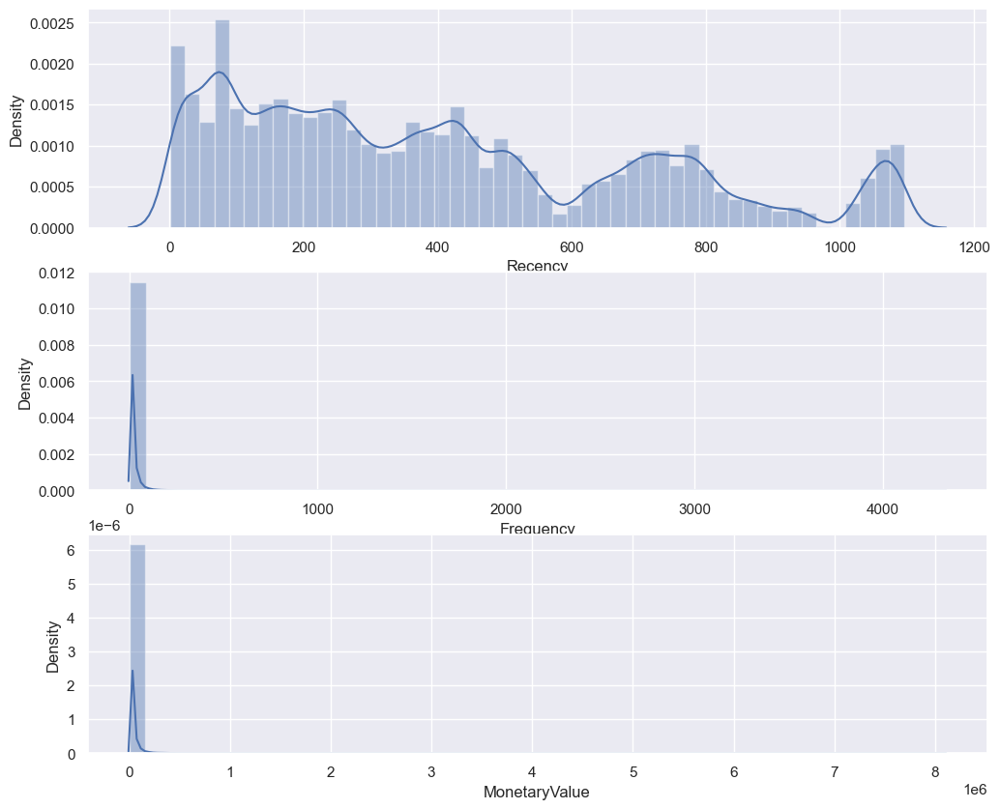

In [14]:
plt.figure(figsize=(12,10))

# Plot recency distribution
plt.subplot(3, 1, 1); sns.distplot(rfm['Recency'])

# Plot frequency distribution
plt.subplot(3, 1, 2); sns.distplot(rfm['Frequency'])

# Plot monetary value distribution
plt.subplot(3, 1, 3); sns.distplot(rfm['MonetaryValue'])

# Show the plot
plt.show()

As we can see from the above plots, all the variables do not have a symmetrical distribution. All of them are skewed to the right. To remove the skewness, we can try the following transformations:
<ol type="1">
<li>log transformations</li>
<li>Box-Cox transformations</li>
<li>Cube root transformations</li>
</ol>
The log transformation cannot be used for negative values. One common practice one can use here is to add a constant value to get a positive value and this is generally taken as the absolute of the least negative value of the variable to each observation. However, in our data, we do not have any negative values since we are dealing with customer transactions dataset.

In [15]:
from scipy import stats
def analyze_skewness(x):
    fig, ax = plt.subplots(2, 2, figsize=(5,5))
    sns.distplot(rfm[x], ax=ax[0,0])
    sns.distplot(np.log(rfm[x]), ax=ax[0,1])
    sns.distplot(np.sqrt(rfm[x]), ax=ax[1,0])
    sns.distplot(stats.boxcox(rfm[x])[0], ax=ax[1,1])
    plt.tight_layout()
    plt.show()
    
    
    print('Log Transform : The skew coefficient of', rfm[x].skew().round(2), 'to', np.log(rfm[x]).skew().round(2))
    print('Square Root Transform : The skew coefficient of', rfm[x].skew().round(2), 'to', np.sqrt(rfm[x]).skew().round(2))
    print('Box-Cox Transform : The skew coefficient of', rfm[x].skew().round(2), 'to', pd.Series(stats.boxcox(rfm[x])[0]).skew().round(2))

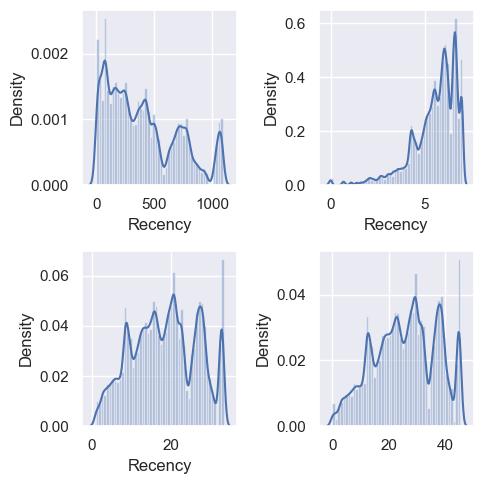

Log Transform : The skew coefficient of 0.66 to -1.45
Square Root Transform : The skew coefficient of 0.66 to -0.03
Box-Cox Transform : The skew coefficient of 0.66 to -0.16


In [16]:
analyze_skewness('Recency')

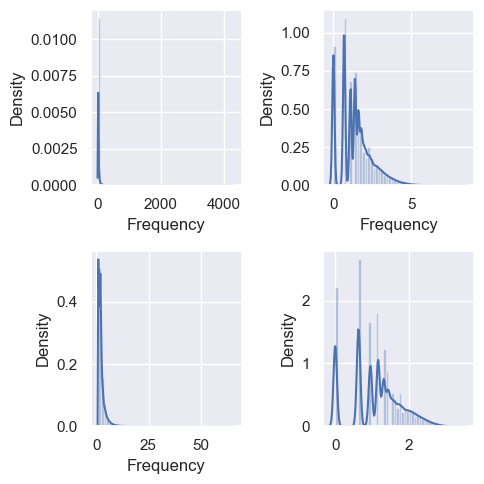

Log Transform : The skew coefficient of 39.7 to 0.74
Square Root Transform : The skew coefficient of 39.7 to 3.78
Box-Cox Transform : The skew coefficient of 39.7 to 0.04


In [17]:
analyze_skewness('Frequency')

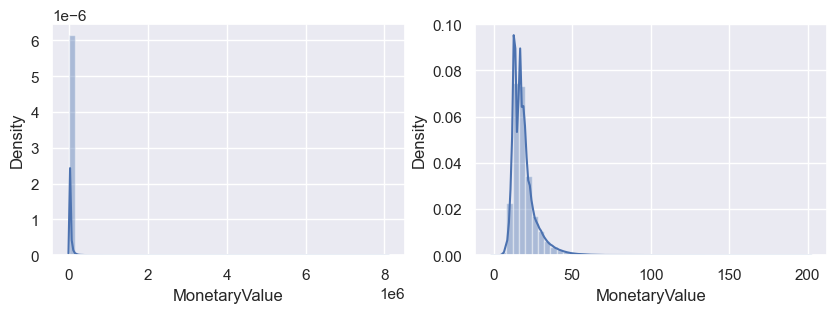

66.32
2.27


In [18]:
fig, ax = plt.subplots(1, 2, figsize=(10,3))
sns.distplot(rfm['MonetaryValue'], ax=ax[0])
sns.distplot(np.cbrt(rfm['MonetaryValue']), ax=ax[1])
plt.show()
print(rfm['MonetaryValue'].skew().round(2))
print(np.cbrt(rfm['MonetaryValue']).skew().round(2))

In [19]:
# Set the Numbers
from scipy import stats
customers_fix = pd.DataFrame()
customers_fix["Recency"] = stats.boxcox(rfm['Recency'])[0]
customers_fix["Frequency"] = stats.boxcox(rfm['Frequency'])[0]
customers_fix["MonetaryValue"] = pd.Series(np.cbrt(rfm['MonetaryValue'])).values
customers_fix.tail()

,Recency,Frequency,MonetaryValue
643776,20.218111,1.167247,17.322563
643777,20.065915,1.437462,20.405875
643778,22.356589,1.319416,20.949995
643779,22.176344,1.167247,19.125667
643780,18.121678,1.167247,17.322560


In [20]:
# Import library
from sklearn.preprocessing import StandardScaler
# Initialize the Object
scaler = StandardScaler()
# Fit and Transform The Data
scaler.fit(customers_fix)
customers_normalized = scaler.transform(customers_fix)
# Assert that it has mean 0 and variance 1
print(customers_normalized.mean(axis = 0).round(2)) 
print(customers_normalized.std(axis = 0).round(2)) 

[-0.  0. -0.]
[1. 1. 1.]


In [39]:
customers_normalized_df = pd.DataFrame(customers_normalized)
# Rename columns
customers_normalized_df.rename(columns={0: 'Recency', 
                         1: 'Frequency', 
                         2: 'MonetaryValue'}, inplace=True)
customers_normalized_df.head()

,Recency,Frequency,MonetaryValue
0,-0.455966,0.922435,0.213462
1,0.198714,1.129113,1.294505
2,-0.083692,0.999124,0.818963
3,-0.783084,1.236132,0.668323
4,1.003805,-0.225835,-0.188821


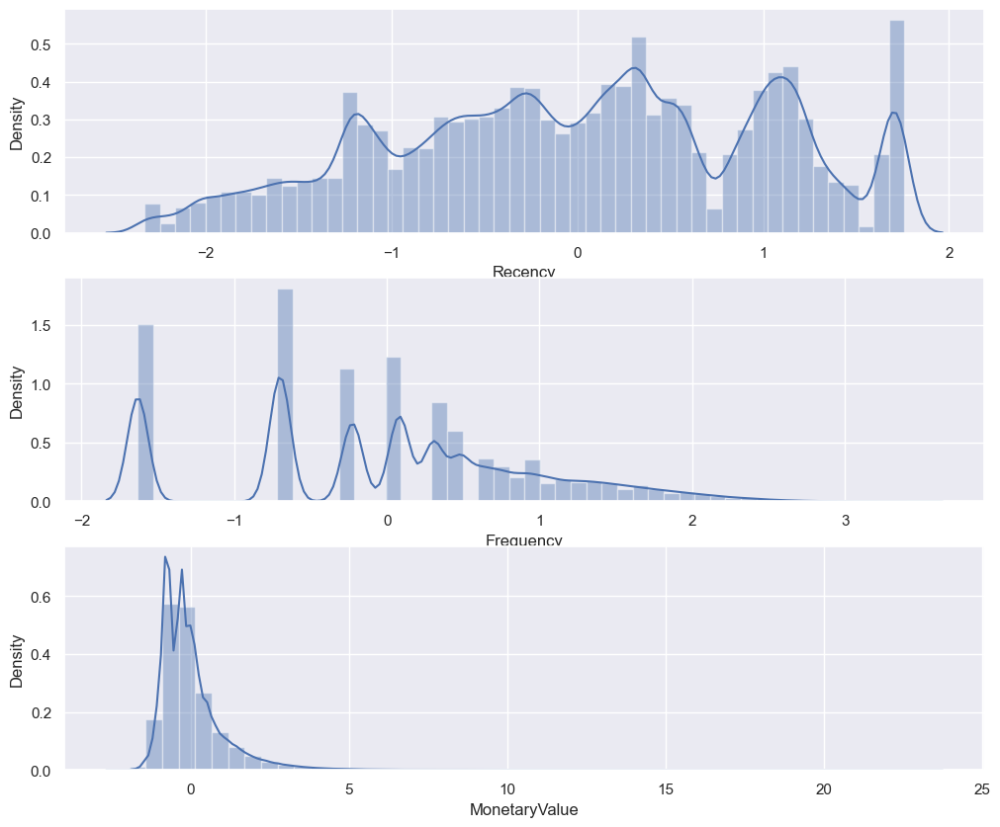

In [40]:
plt.figure(figsize=(12,10))

# Plot recency distribution
plt.subplot(3, 1, 1); sns.distplot(customers_normalized_df['Recency'])
# Plot frequency distribution
plt.subplot(3, 1, 2); sns.distplot(customers_normalized_df['Frequency'])

# Plot monetary value distribution
plt.subplot(3, 1, 3); sns.distplot(customers_normalized_df['MonetaryValue'])

# Show the plot
plt.show()

In [21]:
pd.DataFrame(customers_normalized).head()

,0,1,2
0,-0.455966,0.922435,0.213462
1,0.198714,1.129113,1.294505
2,-0.083692,0.999124,0.818963
3,-0.783084,1.236132,0.668323
4,1.003805,-0.225835,-0.188821


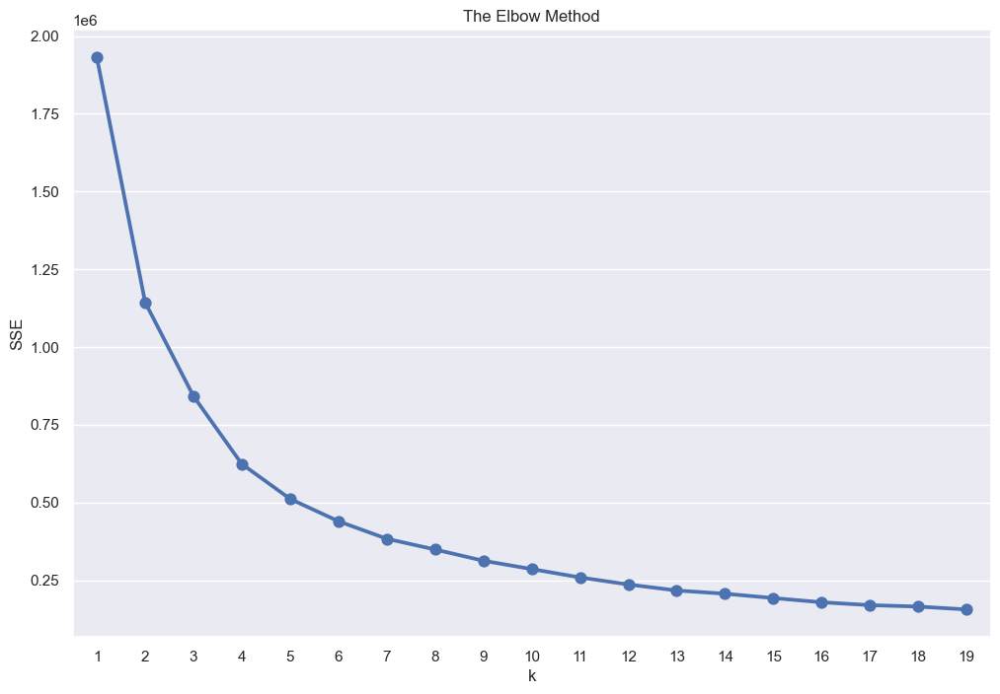

In [22]:
plt.figure(figsize=(12,8))

from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
K = range(1, 20)

distortions = []
inertias = []
mapping1 = {}
sse = {}
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(customers_normalized)
    
    distortions.append(sum(np.min(cdist(customers_normalized, kmeans.cluster_centers_,
                                        'euclidean'), axis=1)) / customers_normalized.shape[0])
    inertias.append(kmeans.inertia_)
 
    mapping1[k] = sum(np.min(cdist(customers_normalized, kmeans.cluster_centers_,
                                   'euclidean'), axis=1)) / customers_normalized.shape[0]
    
    sse[k] = kmeans.inertia_ # SSE to closest cluster centroid

plt.title('The Elbow Method')
plt.xlabel('k')
plt.ylabel('SSE')
sns.pointplot(x=list(sse.keys()), y=list(sse.values()))
plt.show()

In [23]:
for key, val in mapping1.items():
    print(f'{key} : {val}')

1 : 1.513967030698394
2 : 1.19291585591603
3 : 1.02208901352912
4 : 0.874996907687476
5 : 0.8005031837259426
6 : 0.7425497833447006
7 : 0.6883534981216664
8 : 0.6501182373273636
9 : 0.6212380124817928
10 : 0.5925106700439172
11 : 0.5620451628339705
12 : 0.5360221126418281
13 : 0.5117696609241393
14 : 0.5028947977378225
15 : 0.4843847871162485
16 : 0.4702482279368917
17 : 0.4587081822154947
18 : 0.4507068563929068
19 : 0.43945062376400196


In [24]:
model = KMeans(n_clusters=3, random_state=42)
model.fit(customers_normalized)
model.labels_.shape

(643781,)

In [25]:
rfm["Cluster"] = model.labels_
rfm.head()

,user_id,Recency,Frequency,MonetaryValue,Cluster
0,50049,205,10,8805.0001,1
1,50174,386,13,24389.9998,2
2,50511,300,11,16246.0021,2
3,50565,138,15,14108.0010,2
4,53762,701,3,5397.9999,0


In [26]:
rfm.groupby('Cluster').agg({
    'Recency':'mean',
    'Frequency':'mean',
    'MonetaryValue':['mean', 'count']}).round(1)

Recency Frequency MonetaryValue        
           mean      mean          mean   count
Cluster                                        
0         654.1       3.1        4228.5  283755
1         161.0       3.9        5214.3  228510
2         265.3      27.5       37176.0  131516

In [27]:
model = KMeans(n_clusters=4, random_state=42)
model.fit(customers_normalized)
model.labels_.shape

rfm["Cluster"] = model.labels_
rfm.head()
rfm.groupby('Cluster').agg({
    'Recency':'mean',
    'Frequency':'mean',
    'MonetaryValue':['mean', 'count']}).round(1)

Recency Frequency MonetaryValue        
           mean      mean          mean   count
Cluster                                        
0         629.7       6.0        7811.0  192307
1         131.9       4.4        5908.4  193889
2         196.8      35.0       47449.1   89733
3         553.8       1.5        2235.2  167852

In [28]:
df_normalized = pd.DataFrame(customers_normalized, columns=['Recency', 'Frequency', 'MonetaryValue'])
df_normalized['ID'] = rfm.index
df_normalized['Cluster'] = model.labels_
df_normalized.head()

,Recency,Frequency,MonetaryValue,ID,Cluster
0,-0.455966,0.922435,0.213462,0,1
1,0.198714,1.129113,1.294505,1,2
2,-0.083692,0.999124,0.818963,2,0
3,-0.783084,1.236132,0.668323,3,2
4,1.003805,-0.225835,-0.188821,4,0


In [29]:
df_nor_melt = pd.melt(df_normalized.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['Recency','Frequency','MonetaryValue'],
                      var_name='Attribute',
                      value_name='Value')
df_nor_melt.head()

,ID,Cluster,Attribute,Value
0,0,1,Recency,-0.455966
1,1,2,Recency,0.198714
2,2,0,Recency,-0.083692
3,3,2,Recency,-0.783084
4,4,0,Recency,1.003805


In [30]:
fig3 = df_nor_melt.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()


# Rename columns
fig3.rename(columns={'ID': 'Count'}, inplace=True)
fig3['percent'] = (fig3['Count'] / fig3['Count'].sum()) * 100
fig3['percent'] = fig3['percent'].round(1)

fig3.head()

,Cluster,Count,percent
0,0,576921,29.9
1,1,581667,30.1
2,2,269199,13.9
3,3,503556,26.1


In [32]:
colors=['#bad0af','#d5e0cf','#f1f1f1','#f1d4d4'] #color palette
import plotly.express as px

fig = px.treemap(fig3, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution of Cluster")

fig.update_layout(
    treemapcolorway = colors, #defines the colors in the treemap
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

<Axes: xlabel='Attribute', ylabel='Value'>

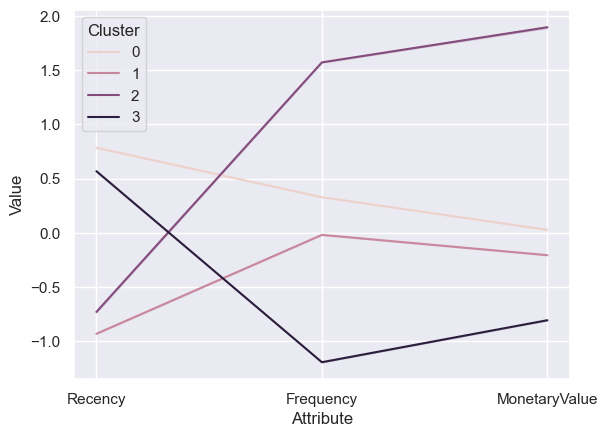

In [41]:
sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt)

In [42]:
rfm.groupby('Cluster').agg({
    'Recency':'mean',
    'Frequency':'mean',
    'MonetaryValue':['mean', 'count']}).round(1)

Recency Frequency MonetaryValue        
           mean      mean          mean   count
Cluster                                        
0         629.7       6.0        7811.0  192307
1         131.9       4.4        5908.4  193889
2         196.8      35.0       47449.1   89733
3         553.8       1.5        2235.2  167852

In [43]:
cluster_avg = rfm.groupby('Cluster').mean()
population_avg = rfm.mean()
relative_imp = cluster_avg / population_avg - 1
relative_imp

,Cluster,Frequency,MonetaryValue,Recency,user_id
Cluster,,,,,
0,NaN,-0.286605,-0.309320,0.575547,-0.029967
1,NaN,-0.471613,-0.477553,-0.669840,0.055826
2,NaN,3.174036,3.195627,-0.507552,-0.083343
3,NaN,-0.823696,-0.802353,0.385679,0.014402


In [44]:
rfm_fig = rfm.copy()

#Remove the outlier for visualization
y1 = rfm_fig['Frequency']
size = rfm_fig.shape[0]
removed_outliers = y1.between(y1.quantile(.05), y1.quantile(.95))
print(str(y1[removed_outliers].size) + "/" + str(size) + " data points remain.") 
index_names = rfm_fig[~removed_outliers].index 
rfm_fig.drop(index_names, inplace=True)

#Remove the outlier for visualization
y2 = rfm_fig['Recency']
size = rfm_fig.shape[0]
removed_outliers = y2.between(y2.quantile(.05), y2.quantile(.95))
print(str(y2[removed_outliers].size) + "/" + str(size) + " data points remain.") 
index_names = rfm_fig[~removed_outliers].index 
rfm_fig.drop(index_names, inplace=True)

#Remove the outlier for visualization
y3 = rfm_fig['MonetaryValue']
size = rfm_fig.shape[0]
removed_outliers = y3.between(y3.quantile(.05), y3.quantile(.95))
print(str(y3[removed_outliers].size) + "/" + str(size) + " data points remain.") 
index_names = rfm_fig[~removed_outliers].index 
rfm_fig.drop(index_names, inplace=True)

611691/643781 data points remain.
551685/611691 data points remain.
496621/551685 data points remain.


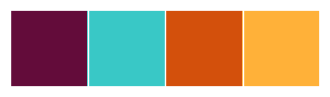

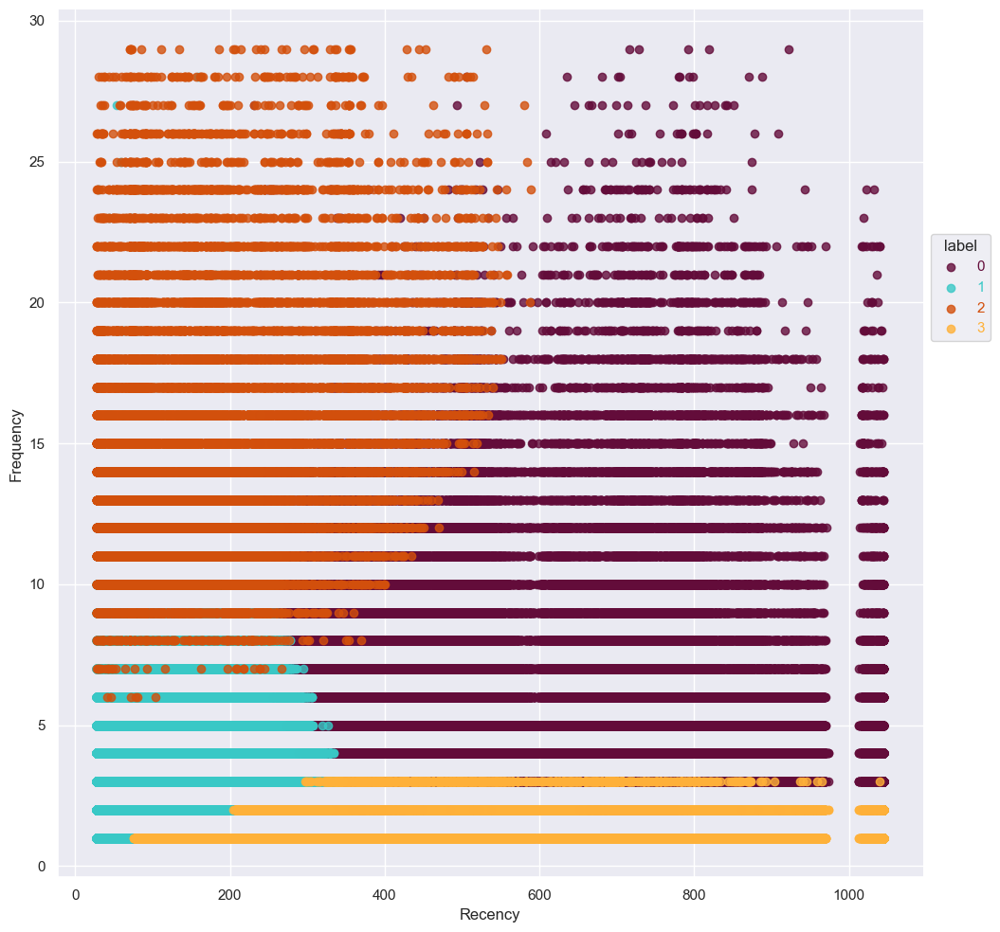

In [45]:
#define a custom palette
customPalette = ['#630C3A', '#39C8C6', '#D3500C', '#FFB139']
sns.set_palette(customPalette)
sns.palplot(customPalette)

data = pd.DataFrame(data=rfm_fig,columns=['Customer ID','Cluster','Recency','Frequency','MonetaryValue'])

#plot data with seaborn (don't add a legend yet)
facet = sns.lmplot(data=data, x='Recency', y='Frequency', hue='Cluster', height=10,
                   fit_reg=False, legend=False)

#add a legend
leg = facet.ax.legend(bbox_to_anchor=[1, 0.75],
                         title="label", fancybox=True)
#change colors of labels
for i, text in enumerate(leg.get_texts()):
    plt.setp(text, color = customPalette[i])

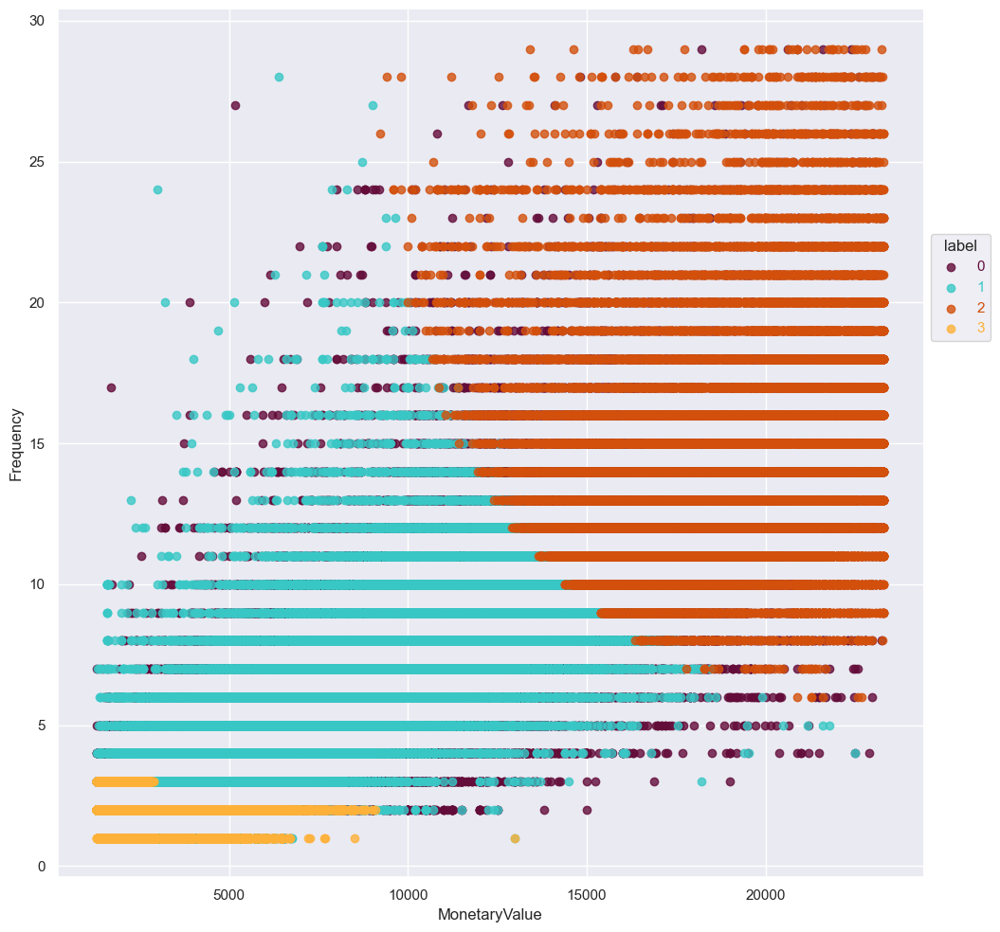

In [46]:
# fig, ax = plt.subplots(figsize=(10, 8))
#plot data with seaborn (don't add a legend yet)
facet = sns.lmplot(data=data, x='MonetaryValue', y='Frequency', hue='Cluster', height=10,
                   fit_reg=False, legend=False)

#add a legend
leg = facet.ax.legend(bbox_to_anchor=[1, 0.75],
                         title="label", fancybox=True)
#change colors of labels
for i, text in enumerate(leg.get_texts()):
    plt.setp(text, color = customPalette[i])

In [52]:
rfm_fig['Cluster'] = rfm_fig['Cluster'].astype(str)

import plotly.express as px
fig = px.scatter_3d(rfm_fig,x='Recency', y='Frequency', z='MonetaryValue',
              color='Cluster', opacity=0.7,color_discrete_sequence=px.colors.qualitative.G10)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [53]:
cluster_avg = rfm[['Cluster','Recency','Frequency','MonetaryValue']].groupby(['Cluster']).mean()
population_avg = rfm[['Recency','Frequency','MonetaryValue']].head().mean()

In [54]:
cluster_avg

,Recency,Frequency,MonetaryValue
Cluster,,,
0,629.668234,5.979179,7811.022105
1,131.948806,4.428570,5908.449075
2,196.807139,34.983863,47449.105667
3,553.787527,1.477659,2235.227276


In [55]:
population_avg

Recency            346.00000
Frequency           10.40000
MonetaryValue    13789.40058
dtype: float64

In [56]:
relative_imp = cluster_avg / population_avg - 1
relative_imp.round(2)

,Recency,Frequency,MonetaryValue
Cluster,,,
0,0.82,-0.43,-0.43
1,-0.62,-0.57,-0.57
2,-0.43,2.36,2.44
3,0.60,-0.86,-0.84


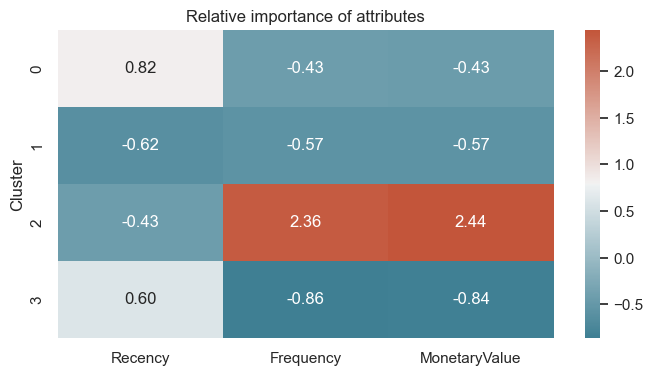

In [57]:
cmap = sns.diverging_palette(220, 20, as_cmap=True)
# Plot heatmap
plt.figure(figsize=(8, 4))
plt.title('Relative importance of attributes')
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap=cmap)
plt.show()

In [58]:
quantiles = rfm.quantile(q=[0.2,0.4,0.6,0.8])
quantiles = quantiles.to_dict()
    
def RScore(x,p,d):
    if x <= d[p][0.2]:
        return 5
    elif x <= d[p][0.4]:
        return 4
    elif x <= d[p][0.6]: 
        return 3
    elif x <= d[p][0.8]: 
        return 2
    else:
        return 1   
    
def FMScore(x,p,d):
    if x <= d[p][0.2]:
        return 1
    elif x <= d[p][0.4]:
        return 2
    elif x <= d[p][0.6]: 
        return 3
    elif x <= d[p][0.8]: 
        return 4
    else:
        return 5
    
rfm['R'] = rfm['Recency'].apply(RScore, args=('Recency',quantiles,))
rfm['F'] = rfm['Frequency'].apply(FMScore, args=('Frequency',quantiles,))
rfm['M'] = rfm['MonetaryValue'].apply(FMScore, args=('MonetaryValue',quantiles,))

In [59]:
# Concat RFM quartile values to create RFM Segments
def join_rfm(x): return str(x['R']) + str(x['F']) + str(x['M'])
rfm['RFM_Segment'] = rfm.apply(join_rfm, axis=1)
# Calculate RFM_Score
rfm['RFM_Score'] = rfm[['R','F','M']].sum(axis=1)

In [60]:
rfm['RFM_Segment'].unique()

array(['4.05.04.0', '3.05.05.0', '4.05.05.0', '2.02.03.0', '5.04.04.0',
       '5.05.05.0', '2.04.04.0', '4.04.04.0', '3.01.02.0', '5.05.04.0',
       '3.04.05.0', '1.02.01.0', '1.03.03.0', '1.05.05.0', '1.04.03.0',
       '3.04.03.0', '3.01.01.0', '1.03.04.0', '1.01.01.0', '5.04.05.0',
       '5.02.03.0', '4.02.03.0', '4.03.03.0', '2.01.01.0', '3.04.04.0',
       '4.01.02.0', '2.03.04.0', '1.02.03.0', '2.05.05.0', '1.02.02.0',
       '3.03.04.0', '3.01.03.0', '5.01.01.0', '5.03.03.0', '3.02.04.0',
       '3.02.03.0', '2.01.02.0', '4.02.02.0', '3.05.04.0', '1.04.04.0',
       '3.02.02.0', '5.01.02.0', '1.01.02.0', '2.01.03.0', '5.03.04.0',
       '4.04.03.0', '4.03.02.0', '5.03.02.0', '2.02.02.0', '2.04.02.0',
       '2.03.02.0', '2.03.03.0', '2.04.05.0', '4.04.02.0', '4.01.01.0',
       '3.03.03.0', '2.03.01.0', '1.01.03.0', '2.04.03.0', '5.04.03.0',
       '4.04.05.0', '4.03.04.0', '5.02.02.0', '5.01.03.0', '1.02.04.0',
       '3.03.02.0', '2.05.04.0', '2.02.01.0', '1.03.02.0', '1.03

In [61]:
# Create human friendly RFM labels
segt_map = {
    
    r'[1-2][1-2]': 'Hibernating',
    r'[1-2][3-4]': 'At risk',
    r'[1-2]5': 'Can\'t lose them',
    r'3[1-2]': 'About to sleep',
    r'33': 'Need attention',
    r'[3-4][4-5]': 'Loyal customers',
    r'41': 'Promising',
    r'51': 'Price Sensitive',
    r'[4-5][2-3]': 'Potential loyalists',
    r'5[4-5]': 'Champions'
}
#rfm['Segment'] = rfm['R'].map(str) + rfm['F'].map(str)+ rfm['M'].map(str)
rfm['Segment'] = rfm['R'].map(str) + rfm['F'].map(str)
rfm['Segment'] = rfm['Segment'].replace(segt_map, regex=True)
# Create some human friendly labels for the scores
rfm['Score'] = 'Green'
rfm.loc[rfm['RFM_Score']>5,'Score'] = 'Bronze' 
rfm.loc[rfm['RFM_Score']>7,'Score'] = 'Silver' 
rfm.loc[rfm['RFM_Score']>9,'Score'] = 'Gold' 
rfm.loc[rfm['RFM_Score']>10,'Score'] = 'Platinum'
# List the head of the table to view the 
rfm.loc[rfm['Cluster']<1,'Segment'] = 'New Customers'
rfm.loc[rfm['Cluster']<1,'Score'] = 'Green'
rfm.head(5)

,user_id,Recency,Frequency,MonetaryValue,Cluster,R,F,M,RFM_Segment,RFM_Score,Segment,Score
0,50049,205,10,8805.0001,1,4,5,4,4.05.04.0,13,Loyal customers,Platinum
1,50174,386,13,24389.9998,2,3,5,5,3.05.05.0,13,Loyal customers,Platinum
2,50511,300,11,16246.0021,0,3,5,5,3.05.05.0,13,New Customers,Green
3,50565,138,15,14108.0010,2,4,5,5,4.05.05.0,14,Loyal customers,Platinum
4,53762,701,3,5397.9999,0,2,2,3,2.02.03.0,7,New Customers,Green


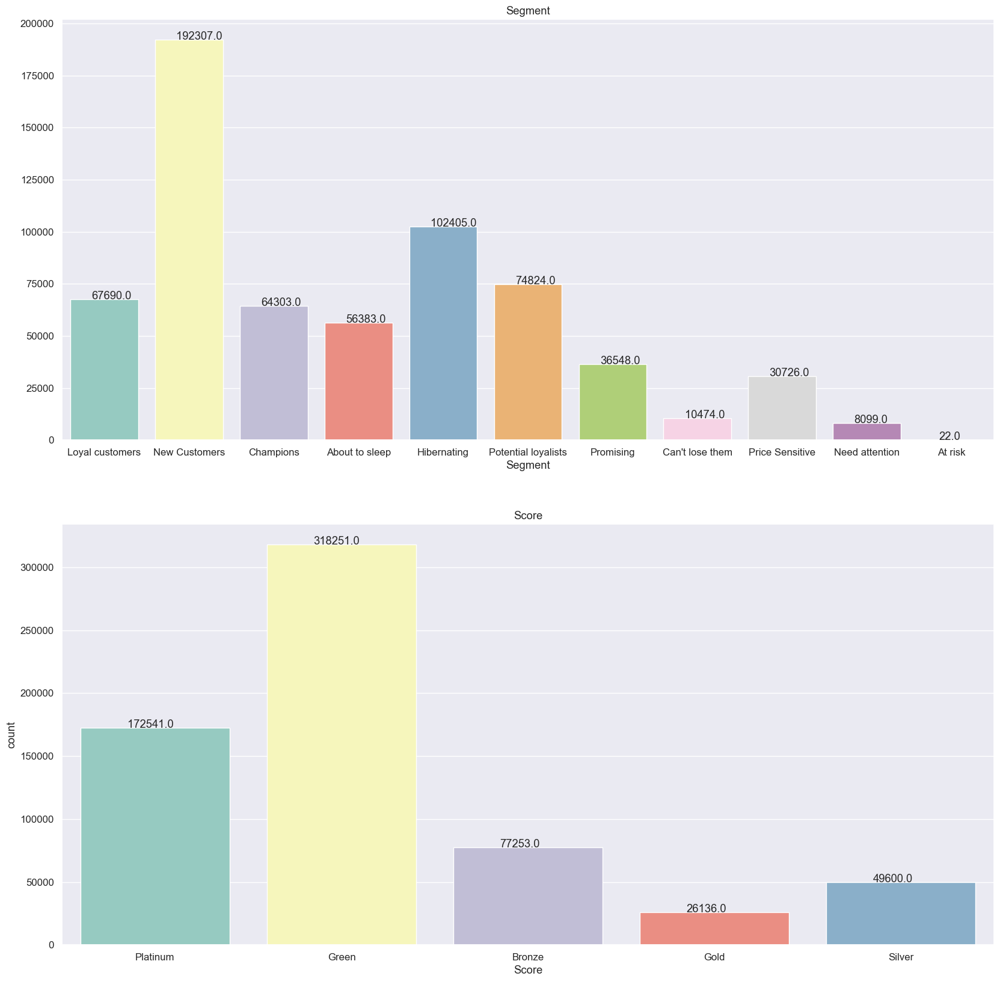

In [67]:
import matplotlib.pyplot as plt


sns.set(font_scale=1.1)

#Pie Chart
f,ax=plt.subplots(2,1,figsize=(20,20))
sns.countplot(x='Segment',data=rfm,ax=ax[0],palette="Set3")
ax[0].set_title('Segment')
ax[0].set_ylabel('')
#ax[0].set_title('Survival count by IsAlone')
# ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=90)

#Bar chart - count
sns.countplot(x='Score',data=rfm,ax=ax[1],palette="Set3")
ax[1].set_title('Score')

for p in ax[0].patches:
    ax[0].annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.25, p.get_height()+20))

for p in ax[1].patches:
    ax[1].annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.25, p.get_height()+20))


plt.show()

In [68]:
# Aggregate data by each customer
fig3 = rfm.groupby('Segment').agg({'user_id': lambda x: len(x)}).reset_index()

# Rename columns
fig3.rename(columns={'user_id': 'Count'}, inplace=True)
fig3['percent'] = (fig3['Count'] / fig3['Count'].sum()) * 100
fig3['percent'] = fig3['percent'].round(1)

fig3.head()

,Segment,Count,percent
0,About to sleep,56383,8.8
1,At risk,22,0.0
2,Can't lose them,10474,1.6
3,Champions,64303,10.0
4,Hibernating,102405,15.9


In [69]:
colors=['#83af70','#9fbf8f','#bad0af','#d5e0cf','#f1f1f1','#f1d4d4','#f0b8b8','#ec9c9d'] #color palette
import plotly.express as px

fig = px.treemap(fig3, path=['Segment'],values='Count'
                 , width=800, height=400
                 ,title="RFM Segments")

fig.update_layout(
    treemapcolorway = colors, #defines the colors in the treemap
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

In [70]:
# Aggregate data by each customer
fig4 = rfm.groupby('Score').agg({'user_id': lambda x: len(x)}).reset_index()


# Rename columns
fig4.rename(columns={'user_id': 'Count'}, inplace=True)
fig4['percent'] = (fig4['Count'] / fig4['Count'].sum()) * 100
fig4['percent'] = fig4['percent'].round(1)

fig4.head()

,Score,Count,percent
0,Bronze,77253,12.0
1,Gold,26136,4.1
2,Green,318251,49.4
3,Platinum,172541,26.8
4,Silver,49600,7.7


In [71]:
colors=['#bad0af','#d5e0cf','#f1f1f1','#f1d4d4'] #color palette
import plotly.express as px

fig = px.treemap(fig4, path=['Score'],values='Count'
                 , width=800, height=400
                 ,title="Treemap of RFM Score")

fig.update_layout(
    treemapcolorway = colors, #defines the colors in the treemap
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

In [72]:
# Aggregate data by each customer
fig5 = rfm.groupby(['Cluster', 'Segment', 'Score']).agg({'user_id': lambda x: len(x)}).reset_index()

# Rename columns
fig5.rename(columns={'user_id': 'Count'}, inplace=True)
fig5['percent'] = (fig5['Count'] / fig5['Count'].sum()) * 100
fig5['percent'] = fig5['percent'].round(1)

fig5.head()
colors=['#bad0af','#d5e0cf','#f1f1f1','#f1d4d4'] #color palette
import plotly.express as px
fig = px.treemap(fig5, path=[px.Constant("Customer"), 'Cluster', 'Segment', 'Score'], values='Count'
                ,title="Treemap of Customer Segment")
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))

fig.update_layout(
    treemapcolorway = colors, #defines the colors in the treemap
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

In [73]:
# Aggregate data by each customer
rfm1 = rfm.groupby(['Cluster','Segment'],).agg({'user_id': lambda x: len(x)}).reset_index()

# Rename columns
rfm1.rename(columns={'user_id': 'Count'}, inplace=True)
rfm1['percent'] = (rfm1['Count'] / rfm1.groupby('Cluster')['Count'].transform('sum')) * 100
rfm1['percent'] = rfm1['percent'].round(1)

rfm1

,Cluster,Segment,Count,percent
0,0,New Customers,192307,100.0
1,1,About to sleep,8453,4.4
2,1,Champions,25625,13.2
3,1,Loyal customers,27113,14.0
4,1,Need attention,8086,4.2
5,1,Potential loyalists,74822,38.6
6,1,Price Sensitive,28514,14.7
7,1,Promising,21276,11.0
8,2,At risk,2,0.0
9,2,Can't lose them,10474,11.7


In [75]:
df_merge = pd.merge(df, rfm, on = "user_id", how = "inner") 
df_merge_rfm = df_merge

In [76]:
selected_features = ['user_id', 'line_item_amount', 'bill_discount','Cluster','Segment','RFM_Score','Score']
zscore_threshold = 4
df_merge.Segment = df_merge.Segment.astype('category').cat.codes
df_merge.Score = df_merge.Score.astype('category').cat.codes
# Calculate mean and standard deviation for selected features
means = df_merge[selected_features].mean()
stds = df_merge[selected_features].std()
# Calculate Z-scores for selected features
z_scores = ((df_merge[selected_features] - means) / stds)
# Detect outliers based on the threshold
outliers = (np.abs(z_scores) > zscore_threshold).any(axis=1)
df_merge['isSuspect'] = outliers

In [79]:
df_merge['isSuspect'].value_counts()

isSuspect
False    5353007
True       42717
Name: count, dtype: int64

In [81]:
from sklearn.model_selection import train_test_split
X=df_merge[['user_id', 'transaction_date',	'bill_id',	'line_item_amount',	'bill_discount', 'Cluster','Segment','Score','RFM_Score', 'Recency', 'Frequency','MonetaryValue', 'isSuspect']].iloc[:,:-1] #selection feature set
X = X.drop(columns = 'transaction_date')
Y=df_merge[['user_id', 'transaction_date',	'bill_id',	'line_item_amount',	'bill_discount', 'Cluster','Segment','Score','RFM_Score', 'Recency', 'Frequency','MonetaryValue','isSuspect']].iloc[:,-1:]
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.3,random_state=1234) 
import lightgbm as lgb
data_train = lgb.Dataset(x_train, label=y_train)
params = {}
params['learning_rate'] = 0.003
params['boosting_type'] = 'gbdt'
params['objective'] = 'binary'
params['metric'] = 'binary_logloss'
params['sub_feature'] = 0.5
params['num_leaves'] = 10
params['min_data'] = 50
params['max_depth'] = 10
clf = lgb.train(params, data_train, 100)
y_pred=clf.predict(x_test)
for i in range(len(y_pred)):
    if y_pred[i]>=.01:       # setting threshold to .5
       y_pred[i]=1
    else:  
       y_pred[i]=0

from sklearn.metrics import confusion_matrix
confusion_mat= confusion_matrix(y_test, y_pred)#Accuracy
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred,y_test)
print("accuracy : %d%%"%(accuracy*100))

#df_merge.anomaly_ae = df_anm.anomaly_ae.astype('category').cat.codes
df_merge['Fraud'] = clf.predict(df_merge[['user_id',	'bill_id',	'line_item_amount',	'bill_discount', 'Cluster','Segment','Score','RFM_Score', 'Recency', 'Frequency','MonetaryValue']])
df_merge["Fraud_ae"] = np.where(df_merge["Fraud"] <= 0.1, 0, 1)

[LightGBM] [Info] Number of positive: 29807, number of negative: 3747199
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1815
[LightGBM] [Info] Number of data points in the train set: 3777006, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007892 -> initscore=-4.834021
[LightGBM] [Info] Start training from score -4.834021
accuracy : 99%


In [83]:
import h2o
from h2o.estimators.deeplearning import H2OAutoEncoderEstimator

In [84]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
; OpenJDK 64-Bit Server VM (Zulu 8.78.0.19-CA-win64) (build 25.412-b08, mixed mode)
  Starting server from D:\vscode_projects\projects\DashBoard\dashboardenv\Lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\RUPESH~1.SIN\AppData\Local\Temp\tmptbonmcml
  JVM stdout: C:\Users\RUPESH~1.SIN\AppData\Local\Temp\tmptbonmcml\h2o_rupesh_singh_started_from_python.out
  JVM stderr: C:\Users\RUPESH~1.SIN\AppData\Local\Temp\tmptbonmcml\h2o_rupesh_singh_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,08 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.2
H2O_cluster_version_age:,"14 days, 21 hours and 46 minutes"
H2O_cluster_name:,H2O_from_python_rupesh_singh_ooybly
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.485 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [101]:
#dfm2 = df_merge.reset_index()
dfm2 = df_merge[['user_id', 'transaction_date',	'bill_id',	'line_item_amount',	'bill_discount', 'Cluster','Segment','Score','RFM_Score', 'Recency', 'Frequency','MonetaryValue','isSuspect','Fraud','Fraud_ae']]
dfm2.set_index("transaction_date", inplace=True)
dfm2.index = pd.to_datetime(dfm2.index)
dfm2.isSuspect = dfm2.isSuspect.astype('category').cat.codes
#dfm2.Score = dfm2.Score.astype('category').cat.codes
data_from_df = h2o.H2OFrame(dfm2)
data_from_df_split = data_from_df.split_frame(ratios = [0.8], seed = 1234)
data_from_df_train = data_from_df_split[0] # using 80% for training
data_from_df_test = data_from_df_split[1]  # using the rest 20% for out-of-bag evaluation

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [102]:
## Set DeepLearning Grid Search Parameters
from h2o.estimators import H2ODeepLearningEstimator
from h2o.grid.grid_search import H2OGridSearch

# create hyperameter and search criteria lists (ranges are inclusive..exclusive))
dl_hyper_params_tune = {
    'activation' : ["Tanh","RectifierWithDropout","TanhWithDropout"],
    'hidden': [[2], [5], [10], [2, 2]],
    'input_dropout_ratio' : [0,0.05],
    'l1': [0, 1e-05, 2e-05, 3e-05, 4e-05, 5e-05, 6e-05, 7e-05, 8e-05, 9e-05, 1e-04],
    'l2': [0, 1e-05, 2e-05, 3e-05, 4e-05, 5e-05, 6e-05, 7e-05, 8e-05, 9e-05, 1e-04]}

In [104]:
random_search_criteria_tune = {'strategy': "RandomDiscrete",
                               'max_runtime_secs': 60, 
                               'seed' : 1234, # make it reproducible
                               'stopping_rounds' : 5, # stop grid search once the best models have similar AUC
                               'stopping_metric' : "MSE",
                               'stopping_tolerance': 1e-3
                              }

In [105]:
stopping_metric = "MSE"
stopping_tolerance = 1e-3
stopping_rounds = 10

In [106]:
## Deep Learning Model

dl_model = H2ODeepLearningEstimator(
    seed = 1234,
    ## here, use "more than enough" epochs - we have early stopping
    epochs=10000, 
    ## early stopping
    stopping_rounds = stopping_rounds,
    stopping_metric = stopping_metric,
    stopping_tolerance = stopping_tolerance,
    autoencoder = True,
    reproducible = True
)

In [107]:
## Run Deep Learning Grid Search
dl_grid = H2OGridSearch(dl_model, hyper_params = dl_hyper_params_tune,
                        grid_id = 'ae_grid',
                        search_criteria = random_search_criteria_tune)

dl_grid.train(x=dfm2, 
              ## early stopping based on timeout (no model should take more than 1 hour - modify as needed)
              max_runtime_secs = 3600, 
              training_frame = data_from_df_train,
              validation_frame = data_from_df_test
             )

deeplearning Grid Build progress: |

██████████████████████████████████████████████| (done) 100%


,activation,hidden,input_dropout_ratio,l1,l2,model_ids
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_1
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_3
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_3


In [91]:
## Run Deep Learning Grid Search
dl_grid = H2OGridSearch(dl_model, hyper_params = dl_hyper_params_tune,
                        grid_id = 'ae_grid',
                        search_criteria = random_search_criteria_tune)

dl_grid.train(x=dfm2, 
              ## early stopping based on timeout (no model should take more than 1 hour - modify as needed)
              max_runtime_secs = 3600, 
              training_frame = data_from_df_train,
              validation_frame = data_from_df_test
             )

deeplearning Grid Build progress: |██████████████████████████████████████████████| (done) 100%


,activation,hidden,input_dropout_ratio,l1,l2,model_ids
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_1
,Tanh,5,0.05,5e-05,0.0001,ae_grid_model_3


In [108]:
dl_grid.get_grid("mse")

,activation,hidden,input_dropout_ratio,l1,l2,model_ids,mse
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_1,0.0207727
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_3,0.0207727
,TanhWithDropout,5,0.05,5e-05,8e-05,ae_grid_model_3,0.0207727


In [109]:
ae_model = h2o.get_model("ae_grid_model_3")

In [110]:
data_from_df.head()

user_id,bill_id,line_item_amount,bill_discount,Cluster,Segment,Score,RFM_Score,Recency,Frequency,MonetaryValue,isSuspect,Fraud,Fraud_ae
4.01235e+08,5.35433e+08,999.5,0,0,7,2,8,1068,5,7247.5,0,0.00624366,0
4.527e+08,5.53177e+08,1399,0,0,7,2,7,936,5,6395,0,0.00626428,0
4.66562e+08,5.9024e+08,1193.18,0,2,2,3,11,752,14,43786,0,0.00656787,0
4.66562e+08,5.9024e+08,1193.18,0,2,2,3,11,752,14,43786,0,0.00656787,0
4.32469e+08,5.74769e+08,99,0,2,5,3,14,139,22,29039.2,0,0.00628798,0
4.59254e+08,5.73487e+08,1399,0,0,7,2,7,816,5,6301,0,0.00626428,0
4.65459e+08,5.88014e+08,99,0,1,5,3,11,252,6,9335.2,0,0.00627118,0
4.58191e+08,5.6989e+08,979.3,0,3,4,2,3,835,1,979.3,0,0.00615487,0
4.62815e+08,5.81339e+08,99,0,0,7,2,6,785,4,4097.01,0,0.0061625,0
4.46638e+08,5.43862e+08,999,0,0,7,2,11,1033,20,25739,0,0.00625978,0


In [111]:
testdf = data_from_df
reconstruction_error = ae_model.anomaly(testdf)

In [113]:
testdf

user_id,bill_id,line_item_amount,bill_discount,Cluster,Segment,Score,RFM_Score,Recency,Frequency,MonetaryValue,isSuspect,Fraud,Fraud_ae
4.01235e+08,5.35433e+08,999.5,0,0,7,2,8,1068,5,7247.5,0,0.00624366,0
4.527e+08,5.53177e+08,1399,0,0,7,2,7,936,5,6395,0,0.00626428,0
4.66562e+08,5.9024e+08,1193.18,0,2,2,3,11,752,14,43786,0,0.00656787,0
4.66562e+08,5.9024e+08,1193.18,0,2,2,3,11,752,14,43786,0,0.00656787,0
4.32469e+08,5.74769e+08,99,0,2,5,3,14,139,22,29039.2,0,0.00628798,0
4.59254e+08,5.73487e+08,1399,0,0,7,2,7,816,5,6301,0,0.00626428,0
4.65459e+08,5.88014e+08,99,0,1,5,3,11,252,6,9335.2,0,0.00627118,0
4.58191e+08,5.6989e+08,979.3,0,3,4,2,3,835,1,979.3,0,0.00615487,0
4.62815e+08,5.81339e+08,99,0,0,7,2,6,785,4,4097.01,0,0.0061625,0
4.46638e+08,5.43862e+08,999,0,0,7,2,11,1033,20,25739,0,0.00625978,0


In [112]:
reconstruction_error

Reconstruction.MSE
0.0174176
0.0115894
0.0338663
0.0338663
0.0125425
0.00694109
0.0150031
0.0725403
0.00880989
0.0151186


In [116]:
data_from_df.shape

(5395725, 14)

In [121]:
testdf['anomaly_ae'] = testdf[reconstruction_error["Reconstruction.MSE"] > 0.02]

H2OResponseError: Server error java.lang.IllegalArgumentException:
  Error: Can only append one column
  Request: POST /99/Rapids
    data: {'ast': "(tmp= py_15_sid_9eab (append Key_Frame__upload_b2135672366d3ceaf47bc98733844458.hex (rows Key_Frame__upload_b2135672366d3ceaf47bc98733844458.hex (> (cols_py reconstruction_error_84f4_ae_grid_model_3_on_Key_Frame__upload_b2135672366d3ceaf47bc98733844458.hex 'Reconstruction.MSE') 0.02)) 'anomaly_ae'))", 'session_id': '_sid_9eab'}


H2OResponseError: Server error water.exceptions.H2OKeyNotFoundArgumentException:
  Error: Object 'py_15_sid_9eab' not found for argument: key
  Request: GET /3/Frames/py_15_sid_9eab
    params: {'row_count': '10', 'row_offset': '0', 'column_count': '-1', 'full_column_count': '-1', 'column_offset': '0'}


In [95]:
reconstruction_error = ae_model.anomaly(data_from_df)
data_from_df["anomaly_ae"] = data_from_df[reconstruction_error["Reconstruction.MSE"] > 0.02]
#print("Number of Anomalies: " + str(data_from_df["anomaly_ae"].nrow))
data_from_df["anomaly"] = (reconstruction_error["Reconstruction.MSE"] > 0.02).ifelse(1, 0)
#df_am = data_from_df.as_data_frame()


In [ ]:
h2o.cluster().shutdown()

In [99]:
data_from_df["anomaly"]

H2OResponseError: Server error water.exceptions.H2OKeyNotFoundArgumentException:
  Error: Object 'py_5_sid_9eab' not found for argument: key
  Request: GET /3/Frames/py_5_sid_9eab
    params: {'row_count': '10', 'row_offset': '0', 'column_count': '-1', 'full_column_count': '-1', 'column_offset': '0'}


In [123]:
ae = data_from_df[reconstruction_error["Reconstruction.MSE"] > 0.02]

In [126]:
type(ae.)

h2o.frame.H2OFrame

In [129]:
h2o.as_list(ae, use_pandas=False)

H2OServerError: HTTP 500 Server Error:
{"__meta":{"schema_version":3,"schema_name":"H2OErrorV3","schema_type":"H2OError"},"timestamp":1716884282260,"error_url":"/3/DownloadDataset","msg":"\n\nERROR MESSAGE:\n\nCaught exception: java.lang.NullPointerException\n\n","dev_msg":"\n\nERROR MESSAGE:\n\nCaught exception: java.lang.NullPointerException from: water.api.DatasetServlet.doGet(DatasetServlet.java:34)\n\n","http_status":500,"values":{},"exception_type":"java.lang.NullPointerException","exception_msg":"\n\nERROR MESSAGE:\n\nnull\n\n","stacktrace":["java.lang.NullPointerException","    water.api.DatasetServlet.doGet(DatasetServlet.java:34)","    javax.servlet.http.HttpServlet.service(HttpServlet.java:687)","    javax.servlet.http.HttpServlet.service(HttpServlet.java:790)","    org.eclipse.jetty.servlet.ServletHolder.handle(ServletHolder.java:799)","    org.eclipse.jetty.servlet.ServletHandler.doHandle(ServletHandler.java:554)","    org.eclipse.jetty.server.handler.ScopedHandler.nextHandle(ScopedHandler.java:233)","    org.eclipse.jetty.server.handler.ContextHandler.doHandle(ContextHandler.java:1440)","    org.eclipse.jetty.server.handler.ScopedHandler.nextScope(ScopedHandler.java:188)","    org.eclipse.jetty.servlet.ServletHandler.doScope(ServletHandler.java:505)","    org.eclipse.jetty.server.handler.ScopedHandler.nextScope(ScopedHandler.java:186)","    org.eclipse.jetty.server.handler.ContextHandler.doScope(ContextHandler.java:1355)","    org.eclipse.jetty.server.handler.ScopedHandler.handle(ScopedHandler.java:141)","    org.eclipse.jetty.server.handler.HandlerCollection.handle(HandlerCollection.java:146)","    org.eclipse.jetty.server.handler.HandlerWrapper.handle(HandlerWrapper.java:127)","    water.webserver.jetty9.Jetty9ServerAdapter$LoginHandler.handle(Jetty9ServerAdapter.java:130)","    org.eclipse.jetty.server.handler.HandlerCollection.handle(HandlerCollection.java:146)","    org.eclipse.jetty.server.handler.HandlerWrapper.handle(HandlerWrapper.java:127)","    org.eclipse.jetty.server.Server.handle(Server.java:516)","    org.eclipse.jetty.server.HttpChannel.lambda$handle$1(HttpChannel.java:487)","    org.eclipse.jetty.server.HttpChannel.dispatch(HttpChannel.java:732)","    org.eclipse.jetty.server.HttpChannel.handle(HttpChannel.java:479)","    org.eclipse.jetty.server.HttpConnection.onFillable(HttpConnection.java:277)","    org.eclipse.jetty.io.AbstractConnection$ReadCallback.succeeded(AbstractConnection.java:311)","    org.eclipse.jetty.io.FillInterest.fillable(FillInterest.java:105)","    org.eclipse.jetty.io.ChannelEndPoint$1.run(ChannelEndPoint.java:104)","    org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.runTask(EatWhatYouKill.java:338)","    org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.doProduce(EatWhatYouKill.java:315)","    org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.tryProduce(EatWhatYouKill.java:173)","    org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.run(EatWhatYouKill.java:131)","    org.eclipse.jetty.util.thread.ReservedThreadExecutor$ReservedThread.run(ReservedThreadExecutor.java:409)","    org.eclipse.jetty.util.thread.QueuedThreadPool.runJob(QueuedThreadPool.java:883)","    org.eclipse.jetty.util.thread.QueuedThreadPool$Runner.run(QueuedThreadPool.java:1034)","    java.lang.Thread.run(Thread.java:750)"]}